# Projet 02 : Participez à un concours sur la Smart City
***

**Contexte** : en tant que Data Scientist indépendant, je souhaite travailler sur un projet issu du site de l'ONG "Data is for Good".  
**Projet** : aider Paris à devenir une Smart City. J'ai à ma disposition un jeu de données sur les arbres de Paris avec leurs différentes caractéristiques. En revanche, je ne connaîs pas les moyens techniques (employés, véhicules, outils...) pour la mise en oeuvre suite à ce projet.  
**Objectif** : étudier le jeu de données afin d'extraire les informations pertinentes permettant aux décisionnaires d'élaborer un plan d'action optimal (trajet et ressources) pour l'entretien des arbres de Paris.

***
# I) Démarche méthodologique d'analyse de données

Ma démarche méthodologique consiste en plusieurs étapes : 
 - Présentation générale du dataset avec l'exploration et le nettoyage des données
 - Compréhension du dataset via une analyse univariée sur les variables pertinentes
 - Analyse de la problématique en soulevant les questions métiers suite à la compréhension du dataset
 - Réponses à ces questions via une analyse multivariée
 - Synthèse de l'analyse de données

***
# II) Présentation générale du jeu de données

## 1) Exploration du dataset

Le jeu de données est téléchargeable avec le [lien](https://s3-eu-west-1.amazonaws.com/static.oc-static.com/prod/courses/files/AI+Engineer/Project+2+Participez+%C3%A0+un+concours+sur+la+Smart+City/p2-arbres-fr.csv) et est visualisable sur [opendata.paris.fr](https://opendata.paris.fr/explore/dataset/les-arbres/map/?dataChart=eyJxdWVyaWVzIjpbeyJjb25maWciOnsiZGF0YXNldCI6Imxlcy1hcmJyZXMiLCJvcHRpb25zIjp7fX0sImNoYXJ0cyI6W3siYWxpZ25Nb250aCI6dHJ1ZSwidHlwZSI6ImNvbHVtbiIsImZ1bmMiOiJBVkciLCJ5QXhpcyI6ImlkYmFzZSIsInNjaWVudGlmaWNEaXNwbGF5Ijp0cnVlLCJjb2xvciI6IiMwMDMzNjYifV0sInhBeGlzIjoidHlwZWVtcGxhY2VtZW50IiwibWF4cG9pbnRzIjo1MCwic29ydCI6IiJ9XSwidGltZXNjYWxlIjoiIiwiZGlzcGxheUxlZ2VuZCI6dHJ1ZSwiYWxpZ25Nb250aCI6dHJ1ZX0%3D&disjunctive.typeemplacement&disjunctive.arrondissement&disjunctive.libellefrancais&disjunctive.genre&disjunctive.espece&disjunctive.varieteoucultivar&disjunctive.stadedeveloppement&disjunctive.remarquable&location=13,48.86844,2.30945&basemap=jawg.streets).

Il présente une liste de 200 137 arbres caractérisés par 18 colonnes :
- `id` : identifiant unique de l'arbre
- `type_emplacement` : valeur toujours "Arbre", ne sera pas utile
- `domanialite` : type de possession de l'Etat pour le domaine public (cimetière, périphérique...)
- `arrondissement` : arrondissement de Paris ou département de la petite couronne dans lequel est situé l'arbre
- `complement_adresse` : apporte un complément à l'adresse initiale pour la localisation, à **80% vide**, ne sera pas utile
- `numero` : numéro dans la rue où l'arbre est localisé, à **100% vide**, ne sera pas utile
- `lieu` : lieu (cimetière, parc...) ou adresse (rue, avenue...) où se situe l'arbre, près de **7 000 différents**.
- `id_emplacement` : identifiant alphanumérique de l'emplacement
- `libelle_francais` : genre de l'arbre en français courant (chêne, érable...)
- `genre` : genre de l'arbre en latin (quercus, acer...)
- `espece` : espèce de l'arbre en latin (rubra, pseudoplatanus...), plus de **500 différentes**.
- `variete` : variété de l'arbre, plus de **400 différentes**, à **80% vide**, ne sera pas utile.
- `circonference_cm` : circonférence de l'arbre en cm. **13% de valeurs à zéro**. Valeurs maximum à **250 m**.
- `hauteur_m` : hauteur de l'arbre en m. **20% de valeurs à zéro**. Valeur maximum à **880 km**.
- `stade_developpement` : stade de développement observé : Adulte, Jeune, Jeune Adulte et Mature. **Manque 30% des données**, à voir pour combler.
- `remarquable` : renseigne si l'arbre est de type remarquable, càd repéré par ses diverses propriétés (rareté, dimensions, âge...). **Manque 30% des données**, à voir pour combler.
- `geo_point_2d_a` : latitude de la coordonnée de l'arbre.
- `geo_point_2d_b` : longitude de la coordonnée de l'arbre.

On peut distinguer 3 catégories de colonne : 
- **Identification** : (7) identifiant unique, libellé français (genre), genre, espèce, variété, stade de développement et statut remarquable.
- **Dimensions** : (2) hauteur et circonférence.
- **Localisation** : (9) type d'emplacement, domanialité, arrondissement, complément d'adresse, numéro, lieu, identifiant de l'emplacement et les 2 variables pour les coordonnées géographiques.

## 2) Nettoyage du dataset

### a) Données manquantes

<font size="4"><center>**Données manquantes pour chaque colonne en % (sup. à 0%)**</center></font>
![](missing_data.png)

J’ai complété les colonnes avec lesquelles je vais travailler : 
 - `stade_developpement` : plus de 30% des valeurs remplacées par "Autre"
 - `remarquable` : environ 30% des valeurs remplacées par "Non", car si un arbre avait été remarquable, il aurait été renseigné tout simplement.
 - `libelle_francais` (genre) : moins de 1 % des valeurs remplacées par "Autre"
 - `domanialite` : 1 seule valeur remplacée par "Autre"

<div class="alert alert-block alert-info"><b>NB : </b>Le statut d’arbre remarquable dépend de plusieurs critères : Rareté, Dimensions, Position, Age ou encore Force Symbolique.</div>

### b) Traitement sur les arrondissements et départements

Pour pouvoir exploiter la colonne `arrondissement`, je l'ai converti en chiffre dans une nouvelle colonne `arrond` en faisant les approximations suivantes : 
- les arrondissements vont de **1 à 20**
- les départements de la petite couronne Hauts de Seine, Val de Marne et Seine St Denis sont respectivement **92, 93 et 94**
- le Bois de Vincennes est dans le département du Val de Marne **12**, 6% des arbres
- le Bois de Boulogne est dans le département des Hauts de Seine **16**, 2% des arbres

<div class="alert alert-block alert-info"><b>Approximation : </b>Certains arbres, initialement localisés dans le 12e et le 16e (colonne arrondissement), se trouvent être dans les Bois de Vincennes et de Boulogne si on regarde leur coordonnées géographiques.</div>

### c) Traitement des outliers sur les dimensions

<font size="4"><center>Diagramme en boîte de la circonférence</center></font>|<font size="4"><center>Diagramme en boîte de la hauteur</center></font>
:-|:-
![](boxplot_c_outliers.png)|![](boxplot_h_outliers.png)
<font size="3">Le maximum est à 2.5 km, mais la circonférence maximale connue sur Paris est de 700 cm. On borne donc toutes les valeurs à 700 (moins de 1% des valeurs).</font>|<font size="3">Le maximum est à 800 km, mais la hauteur maximale connue sur Paris est de 31 m. On borne donc toutes les valeurs à 31 (moins de 1% des valeurs).</font>
<font size="3">Les valeurs de circonférence à zéro représentent 13% du total et seront bornées à 1cm.</font>|<font size="3">Les valeurs de hauteur à zéro représentent 20% du total et seront bornées à 1 m.</font>

<div class="alert alert-block alert-success"><b>Simplification : </b>La borne maximale pour les outliers n'a pas été prise en fonction du multiple de l'écart interquartile car il était plus pertient et surtout plus réaliste de se caler sur les données connues.</div>

***
# III) Compréhension du dataset

Voici les variables pertinentes avec lesquelles j'ai réalisé mon étude : 
 - Les dimensions : `circonference_cm` et `hauteur_m`
 - La localisation : `arrond` (approx. de `arrondissement`) et `domanialite`
 - L'identification : `stade_developpement` et `genre`

<font size="4"><center>Répartition de la circonférence</center></font>|<font size="4"><center>Répartition de la hauteur</center></font>
:-|:-
![](circ_h.png)|![](haut_h.png)
<font size="3">La moitié des arbres ont une circonférence allant de 30 à 115 cm.</font>|<font size="3">La moitié des arbres ont une hauteur allant de 5 à 12 m.</font>
<font size="3">La moyenne des circonférences est de 80 cm.</font>|<font size="3">La moyenne des hauteurs est de 8.5 m.</font>
<font size="3">Les arbres ayant une circonférence supérieure à 150 cm représentent 14% de la population.</font>|<font size="3">Les arbres ayant une hauteur supérieure à 15 m représentent 20% de la population.</font>

<font size="4"><center>**Répartition des arrondissements/départements**</center></font>
![](histo_arrond.png)

Il y a très peu d’arbres dans le centre de Paris. Il y a cependant une exception dans le 7e et le 8e. En effet, 30% des arbres dans ces arrondissements sont situés sur les Champs-Elysées, les Invalides et le Champ de Mars.  
Les deux pics observés dans les 12e et 16e arrondissements, sont dû aux Bois de Vincennes et Bois de Boulogne.  
Plus de 80% de la population se situe dans les arrondissements et les départements autour du périphérique.

<font size="4"><center>Répartition de la domanialité</center></font>|<font size="4"><center>Répartition du stade de développement</center></font>
:-|:-
![](histo_doman.png)|![](histo_stade.png)
<font size="3">Plus de 90% de la population se situe dans les alignements, les jardins et les cimetières. Et plus particulièrement, les alignements représentent près de 50% des arbres.</font>|<font size="3">75 % des individus sont aux stades Adulte ou Jeune Adulte. Et plus particulièrement, les arbres étant au stade de développement Adulte représentent près de 50% des arbres.</font>

<font size="4"><center>**Répartition des genres (libellé français)**</center></font>
![](pie_esp_french.png)

Sur un total de 193 genres d’arbres sur Paris, on peut distinguer les 5 principaux : Platane, Marronnier, Tilleul, Erable et Sophora qui représentent 60% des genres présents.

***
# IV) Analyse de la problématique

Nous avons maintenant une meilleure compréhension de notre jeu de données. Suite à cela, j’ai distingué des thèmes qui ont soulevés des questions d’ordre métier en rapport avec notre problématique.
J’ai pu y répondre en m’appuyant sur une analyse multivariée.

Voici les thèmes en questions : 
- les dimensions sont variées
- les localisations sont éparses
- les types d’arbres sont différents

N’étant pas du métier, je ne peux qu’imaginer comment on s’occupe de l’entretien des arbres et donc qu’il y a différents paramètres à prendre en compte dans la décision finale : 
- les outils
- les nacelles
- l’expérience des agents
- la répartition des équipes
- les véhicules
- les compétences de chacun
- et certainement d’autres critères…

Suite à ce constat, voici plusieurs questions qui ont été soulevées : 

<font size="3">**Quelle est la répartition des dimensions en fonction des arrondissements ?**</font>  
<font size="3">**Quelle est la répartition des dimensions en fonction de la domanialité ?**</font>  
> Pour ces 2 questions, nous regarderons la circonférence d'une part et la hauteur d'autre part.  

<font size="3">**Quels sont les principaux genres d’arbre par arrondissement ?**</font>  
<font size="3">**Quelle est la répartition des <mark>arbres remarquables</mark> par arrondissement ?**</font>  
<font size="3">**Quels sont les principaux genres d’<mark>arbre remarquable</mark> ?**</font>  
> Les arbres remarquables sont au nombre de 184 et représentent 0.1% de la population.

## 1) Quelle est la répartition des circonférences en fonction des arrondissements ?

![](circ_arrond.png)

Concernant les arrondissements, la plupart des arbres ont une circonférence comprise entre 27 cm et 135 cm.  
Une plus forte densité de gros arbres est observée dans les arrondissements du 4, 5, 6, 7 et 8e. On y observe une moyenne de 97 cm de circonférence. C’est surtout dans cette zone que seront utiles les outils nécessaires aux gros arbres.  
Dans les arrondissements du 12, 13 et 15e, on observe une plus forte densité d’arbre de moyenne taille avec une moyenne de 73 cm.  
Dans les 3 départements de la petite couronne, on peut voir que les moyennes sont assez basses, càd 50 cm. Les outils permettant de s’occuper des arbres fins seront surtout utilisés dans ces départements.  
On notera les 2 particularités suivantes : 
- dans le 92, 77% des arbres sont à la valeur 1 cm. Soit effectivement, il n’y a que des arbres fins, soit les mesures n’ont pas été prises
- dans le 94, il y a une plus grande disparité des mesures, allant majoritairement de 1 à presque 135 cm.

## 2) Quelle est la répartition des hauteurs en fonction des arrondissements ?

![](haut_arrond.png)

Concernant les arrondissements, les hauteurs varient de 6 à 15 m.  
Comme pour les circonférences, la plus grande proportion de grands arbres se situent dans les arrondissements allant du 4e au 8e, avec une moyenne de 11.5 m.  
Une forte proportion de petits arbres se retrouvent à nouveau dans les départements de la petite couronne, mais aussi dans les arrondissements du 15 et 19e. On a en moyenne une hauteur de 6.5 m.  
On remarque la même particularité que pour les circonférences dans le 92 avec 83% des arbres à la valeur 1 m.

## 3) Quelle est la répartition des circonférences en fonction de la domanialité ?

![](circ_doma.png)

Globalement, la majorité des arbres ne dépassent pas les 115 cm de circonférence.  
On observe une plus grande disparité de circonférence dans les cimetières avec une plus grande proportion d’arbres fins.  
Dans les alignements, il y a une plus grande proportion de gros arbres, allant majoritairement entre 45 et 115 cm de circonférence.

## 4) Quelle est la répartition des hauteurs en fonction de la domanialité ?

![](haut_doma.png)

Dans les jardins et cimetières, et donc dans des conditions plus étriquées, les arbres ne dépassent pas les 10 m.  
Au niveau des alignements, c’est-à-dire le long d’allées assez dégagées, les arbres sont globalement plus grands. C’est donc là que des nacelles spécifiques seront nécessaires.

## 5) Quels sont les principaux genres d’arbre par arrondissement ?

![](genre_par_arrond.png)

Le Platane est effectivement très présent car le principal dans 80% des zones. Il est même dans le top 2 dans tous sauf le 93.  
Les Marronniers sont plutôt situés dans la partie Ouest de Paris (8e, 16e et 17e).  
La proportion d’Erable est plus importante au-delà du 18e arrondissement.  
Les Tilleuls et les Sophora sont surtout présents dans le centre et la partie Sud de Paris (11e au 15e).

## 6) Quelle est la répartition des arbres remarquables par arrondissement ?

![](histo_arrond_rem.png)

On distingue très clairement la forte densité dans les Bois de de Vincennes et de Boulogne. Et dans une moindre mesure, sur le Champ de Mars et au cimetière du Père Lachaise.  
Les 4 arrondissements 7e, 12e, 16e et 20e regroupent à eux seuls 85% des arbres remarquables.  
Près de 80% de la population se situe dans les arrondissements le long du périphérique. A noter qu’il n’y aucun arbre remarquable dans la petite couronne.

## 7) Quels sont les principaux genres d’arbre remarquable ?

![](pie_esp_french_rem.png)

Parmi les 50 genres d'arbre remarquable, on peut distinguer les 11 principaux, montrant qu’ils sont plus diversifiés : Platane, Hêtre, Chêne, Marronnier, Arbre aux quarante écus, Sequoia, Cèdre, Pterocarya, Noisetier de Byzance, Erable et Plaqueminier qui représentent 60% des genres présents.

***
# V) Synthèse de l'analyse de données

## 1) Répartition des grands arbres sur une carte de Paris

![](map_gds.png)

On peut voir plusieurs fortes concentrations, notamment dans le Nord-Est de Paris (cimetière de St-Ouen dans le 93, le 19e, le 20e, et le Bois de Vincennes).  
Nous avons une autre zone dans le Sud de Paris avec le Parc Montsouris et le Cimetière d’Ivry dans le 92.  
Et enfin la zone à cheval sur le 7e, 8e et 16e arrondissement à l’Ouest de Paris.  
Ils nécessitent une logistique particulière avec des nacelles et des agents ayant l’habitude de grimper en hauteur. Ce sont donc des lieux pour y passer plusieurs jours.

## 2) Répartition des petits arbres sur une carte de Paris

![](map_petits.png)

On peut voir plusieurs fortes concentrations, notamment dans le Sud-Est de Paris (le 20e, le 13e et le Bois de Vincennes).  
Plus isolé, nous avons d’une part au Nord, le Cimetière de Pantin dans le 93, et d’autre part au Sud, le Cimetière de Bagneux dans le 92.  
Il y a également toute une zone à l’Ouest dans le 15e arrondissement.  
Leur entretien est plus facile et plus rapide. Plusieurs zones de travail peuvent simultanément envisagées.

## 3) Répartition des arbres remarquables sur une carte de Paris

![](map_remarq.png)

On peut voir plusieurs fortes concentrations, notamment dans l’Ouest de Paris (le Bois de Boulogne, le 16e et le Champ de Mars).  
Une partie non négligeable est également localisée dans la partie Est de Paris (le Cimetière du Père Lachaise et le Bois de Vincennes).  
Ce sont des arbres qui requiert une attention particulière. En effet, ils sont 2 à 3 fois plus massifs que la moyenne des arbres et ont un stade de développement majoritairement Mature.

***
<font size="4">**Conclusions personnelles**</font>  
A mon sens, il est envisageable de créer des équipes par nature d’entretien vu la disposition des petits, grands et remarquables.  
Certains lieux sont dans 2 zones distinctes sur la carte. Alors que certains lieux sont communs. Ce qui pourrait permettre un transfert de compétences et un regain de motivation chez les agents.  
J’espère que cette présentation vous a permis d’acquérir les informations nécessaires vous aidant dans votre décision finale.  
Si néanmoins, ce n’est pas le cas, je suis tout à fait disposé à récupérer d’avantages d’informations (ressources humaines et techniques) pour réaliser une étude additionnelle et revenir vers vous avec des résultats encore plus ciblés.

***
***
# II) Présentation générale du jeu de données

## 1) Exploration du dataset

In [1]:
# import des bibliothèques
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.ticker as mticker
import plotly.express as px

In [2]:
# chargement de données
data = pd.read_csv("p2-arbres-fr.csv", sep=";")
# taille du dataset
print("Dans le dataset, il y a", data.shape[0], "lignes ayant", data.shape[1], "caractéristiques.")
# 5 premières lignes du dataset
data.head()

Dans le dataset, il y a 200137 lignes ayant 18 caractéristiques.


,id,type_emplacement,domanialite,arrondissement,complement_addresse,numero,lieu,id_emplacement,libelle_francais,genre,espece,variete,circonference_cm,hauteur_m,stade_developpement,remarquable,geo_point_2d_a,geo_point_2d_b
0,99874,Arbre,Jardin,PARIS 7E ARRDT,NaN,NaN,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,19,Marronnier,Aesculus,hippocastanum,NaN,20,5,NaN,0.0,48.857620,2.320962
1,99875,Arbre,Jardin,PARIS 7E ARRDT,NaN,NaN,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,20,If,Taxus,baccata,NaN,65,8,A,NaN,48.857656,2.321031
2,99876,Arbre,Jardin,PARIS 7E ARRDT,NaN,NaN,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,21,If,Taxus,baccata,NaN,90,10,A,NaN,48.857705,2.321061
3,99877,Arbre,Jardin,PARIS 7E ARRDT,NaN,NaN,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,22,Erable,Acer,negundo,NaN,60,8,A,NaN,48.857722,2.321006
4,99878,Arbre,Jardin,PARIS 17E ARRDT,NaN,NaN,PARC CLICHY-BATIGNOLLES-MARTIN LUTHER KING,000G0037,Arbre à miel,Tetradium,daniellii,NaN,38,0,NaN,NaN,48.890435,2.315289


In [3]:
# valeurs manquantes classées dans la l'ordre de la plus manquante en pourcentage
valeurs_manquantes = round(data.isnull().mean()*100, 4).sort_values(ascending=False)
pd.DataFrame(valeurs_manquantes, columns = ["%"]).head(19)

,%
numero,100.0000
complement_addresse,84.5596
variete,81.6241
stade_developpement,33.5795
remarquable,31.5274
espece,0.8754
libelle_francais,0.7480
genre,0.0080
domanialite,0.0005
circonference_cm,0.0000


In [4]:
# type de données pour vérifier que les valeurs ont les bons types
data.dtypes

id                       int64
type_emplacement        object
domanialite             object
arrondissement          object
complement_addresse     object
numero                 float64
lieu                    object
id_emplacement          object
libelle_francais        object
genre                   object
espece                  object
variete                 object
circonference_cm         int64
hauteur_m                int64
stade_developpement     object
remarquable            float64
geo_point_2d_a         float64
geo_point_2d_b         float64
dtype: object

In [5]:
# nettoyage des données pour voir les outliers notamment
data.describe()

,id,numero,circonference_cm,hauteur_m,remarquable,geo_point_2d_a,geo_point_2d_b
count,2.001370e+05,0.0,200137.000000,200137.000000,137039.000000,200137.000000,200137.000000
mean,3.872027e+05,NaN,83.380479,13.110509,0.001343,48.854491,2.348208
std,5.456032e+05,NaN,673.190213,1971.217387,0.036618,0.030234,0.051220
min,9.987400e+04,NaN,0.000000,0.000000,0.000000,48.742290,2.210241
25%,1.559270e+05,NaN,30.000000,5.000000,0.000000,48.835021,2.307530
50%,2.210780e+05,NaN,70.000000,8.000000,0.000000,48.854162,2.351095
75%,2.741020e+05,NaN,115.000000,12.000000,0.000000,48.876447,2.386838
max,2.024745e+06,NaN,250255.000000,881818.000000,1.000000,48.911485,2.469759


In [6]:
# valeurs uniques par variables qualitatives pour déterminer la pertinence de leur utilisation
for col in data.columns:
    print(col, " : ", str(len(data[col].unique())))

id  :  200137
type_emplacement  :  1
domanialite  :  10
arrondissement  :  25
complement_addresse  :  3796
numero  :  1
lieu  :  6921
id_emplacement  :  69040
libelle_francais  :  193
genre  :  176
espece  :  540
variete  :  437
circonference_cm  :  531
hauteur_m  :  143
stade_developpement  :  5
remarquable  :  3
geo_point_2d_a  :  200107
geo_point_2d_b  :  200114


## 2) Nettoyage du dataset

### a) Données manquantes

In [7]:
# données manquantes (valeurs à NaN)
nan_values = ["genre", "stade_developpement", "remarquable", "domanialite"]
for nan_val in nan_values:
    temp_nb = len(data.loc[data[nan_val].isnull(),:])
    print("Dans la colonne", nan_val, ", il y a", str(temp_nb), "valeurs manquantes, soit", str(round(temp_nb/len(data)*100, 2)), "% du total.")

Dans la colonne genre , il y a 16 valeurs manquantes, soit 0.01 % du total.
Dans la colonne stade_developpement , il y a 67205 valeurs manquantes, soit 33.58 % du total.
Dans la colonne remarquable , il y a 63098 valeurs manquantes, soit 31.53 % du total.
Dans la colonne domanialite , il y a 1 valeurs manquantes, soit 0.0 % du total.


In [8]:
# on réajuste les NaN à "Autre" ou 0
data.loc[data["remarquable"].isnull(), "remarquable"] = 0.0
data.loc[data["genre"].isnull(),"genre"] = "Autre"
data.loc[data["domanialite"].isnull(), "domanialite"] = "Autre"
data.loc[data["stade_developpement"].isnull(), "stade_developpement"] = "Autre"

### b) Traitement sur les arrondissements et départements

In [9]:
# cas des arbres dans les bois
bois = ["BOIS DE VINCENNES", "BOIS DE BOULOGNE"]
for b in bois:
    temp_bois = data.loc[data["arrondissement"]==b,:]
    print("Il y a", str(len(temp_bois)), "arbres dans le", b, "càd", round(len(temp_bois)/len(data)*100, 2), "% du total.")

Il y a 11510 arbres dans le BOIS DE VINCENNES càd 5.75 % du total.
Il y a 3978 arbres dans le BOIS DE BOULOGNE càd 1.99 % du total.


In [10]:
# colonne arrond pour l'exploitation de la colonne arrondissements/départements
data.loc[data["arrondissement"].str.contains('ARRDT'),"arrond"] = data.loc[data["arrondissement"].str.contains('ARRDT'),"arrondissement"].str.split(' ').str[1].str[:-1]
data.loc[data["arrondissement"]=='VAL-DE-MARNE',"arrond"] = 94
data.loc[data["arrondissement"]=='SEINE-SAINT-DENIS',"arrond"] = 93
data.loc[data["arrondissement"]=='HAUTS-DE-SEINE',"arrond"] = 92
data.loc[data["arrondissement"]=='BOIS DE VINCENNES',"arrond"] = 12
data.loc[data["arrondissement"]=='BOIS DE BOULOGNE',"arrond"] = 16
data.loc[data["arrond"]=='1E',"arrond"] = 1
data.arrond = data.arrond.astype(int)

### c) Traitement des outliers sur les dimensions

In [11]:
# traitement des outliers à zéro
circ_a_zero = data.loc[data["circonference_cm"]==0]
haut_a_zero = data.loc[data["hauteur_m"]==0]
print("Circonférence à zéro :", len(circ_a_zero), ", soit", str(round(len(circ_a_zero)/len(data)*100, 2)), "% du total.")
print("Hauteur à zéro :", len(haut_a_zero), ", soit", str(round(len(haut_a_zero)/len(data)*100, 2)), "% du total.")

Circonférence à zéro : 25867 , soit 12.92 % du total.
Hauteur à zéro : 39219 , soit 19.6 % du total.


In [12]:
# on ajuste les valeurs à zéro à leur valeur min possible càd 1cm et 1m
data.loc[data["hauteur_m"]==0,"hauteur_m"] = 1
data.loc[data["circonference_cm"]==0,"circonference_cm"] = 1

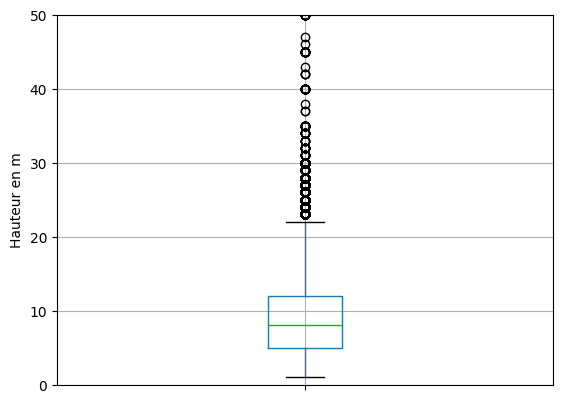

In [13]:
# exploration des outliers max en hauteur
data.boxplot(column="hauteur_m", vert=True, showfliers=True)
plt.ylabel("Hauteur en m")
plt.xticks([1], [''])
plt.ylim((0, 50))
plt.show()

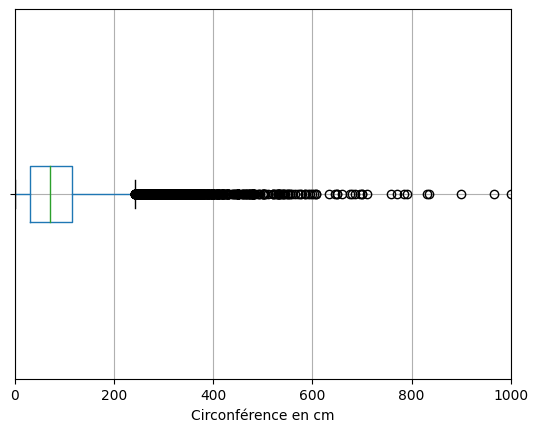

In [14]:
# exploration des outliers max en circonférence
data.boxplot(column="circonference_cm", vert=False, showfliers=True)
plt.xlabel("Circonférence en cm")
plt.yticks([1], [''])
plt.xlim((0, 1000))
plt.show()

In [15]:
# traitement des outliers max pour les dimensions
circ_max = data.loc[data["circonference_cm"]>700]
haut_max = data.loc[data["hauteur_m"]>31]
print("Circonférence au-delà de 700 cm :", len(circ_max), "soit", round(len(circ_max)/len(data)*100, 2), "% du total.")
print("Hauteur au-delà de 31 m :", len(haut_max), "soit", round(len(haut_max)/len(data)*100, 2), "% du total.")

Circonférence au-delà de 700 cm : 82 soit 0.04 % du total.
Hauteur au-delà de 31 m : 558 soit 0.28 % du total.


In [16]:
# on ajuste les valeurs max à leur valeur max réelle observée sur Paris
data.loc[data["circonference_cm"]>700, "circonference_cm"] = 700
data.loc[data["hauteur_m"]>31, "hauteur_m"] = 31

***
# III) Compréhension du dataset

moyenne :  80.00524640621174
médiane :  70.0
mode :  0    1
Name: circonference_cm, dtype: int64
min :  1
max :  700
quartiles :  [30.0, 115.0]
variance :  4092.8101574984807
écart-type :  63.97507450170325
coefficient de variation :  0.7996359910809063
skewness :  1.4141633731935483
kurtosis :  5.609939383020544


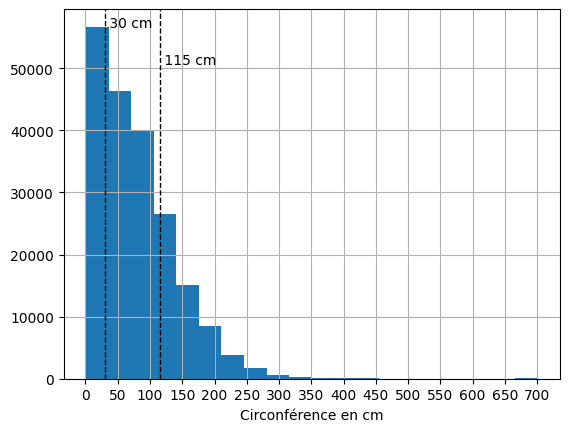

In [17]:
# Etude de la circonférence
# mesures de tendances centrales
print("moyenne : ", data["circonference_cm"].mean())
print("médiane : ", data["circonference_cm"].median())
print("mode : ", data["circonference_cm"].mode())
print("min : ", data["circonference_cm"].min())
print("max : ", data["circonference_cm"].max())
quartiles = [np.percentile(data["circonference_cm"], p) for p in [25, 75]]
print("quartiles : ", quartiles)
# mesures de dispersion
print("variance : ", data["circonference_cm"].var(ddof=0))
print("écart-type : ", data["circonference_cm"].std(ddof=0))
print("coefficient de variation : ", data["circonference_cm"].std(ddof=0)/data["circonference_cm"].mean())
# mesures de forme
print("skewness : ", data["circonference_cm"].skew())
print("kurtosis : ", data["circonference_cm"].kurtosis())
data["circonference_cm"].hist(bins=20)
plt.xlabel("Circonférence en cm")
# pour tracer les 1er et 3ème quartiles
min_ylim, max_ylim = plt.ylim()
plt.xticks(np.arange(0, 701, 50))
plt.axvline(quartiles[0], color='k', linestyle='dashed', linewidth=1)
plt.text(quartiles[0], max_ylim*0.95, ' {:.0f} cm'.format(quartiles[0]))
plt.axvline(quartiles[1], color='k', linestyle='dashed', linewidth=1)
plt.text(quartiles[1], max_ylim*0.85, ' {:.0f} cm'.format(quartiles[1]))
plt.show()

In [18]:
# circonférence > 200 cm
nb_circ_sup = data.loc[data["circonference_cm"]>=150,:]
print("Les arbres ayant une circonférence de plus de 150 cm représentent", round(len(nb_circ_sup)/len(data)*100, 1), "% du total.")

Les arbres ayant une circonférence de plus de 150 cm représentent 14.0 % du total.


moyenne :  8.575046093426003
médiane :  8.0
mode :  0    1
Name: hauteur_m, dtype: int64
min :  1
max :  31
quartiles :  [5.0, 12.0]
variance :  36.174236124253824
écart-type :  6.014502150989209
coefficient de variation :  0.7013958975217851
skewness :  0.6856688093269894
kurtosis :  0.22303759639238674


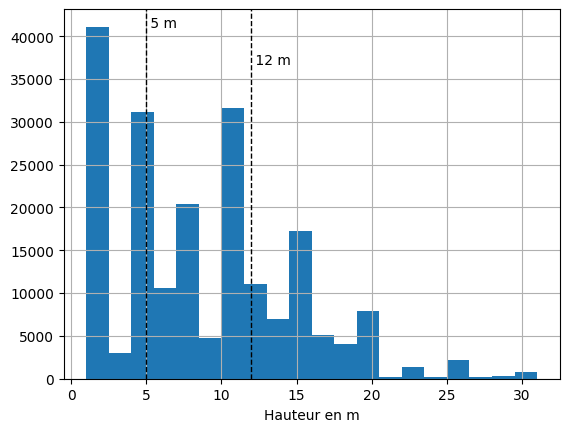

In [19]:
# Etude de la hauteur
data["hauteur_m"].hist(bins=20)
# mesures de tendances centrales
print("moyenne : ", data["hauteur_m"].mean())
print("médiane : ", data["hauteur_m"].median())
print("mode : ", data["hauteur_m"].mode())
print("min : ", data["hauteur_m"].min())
print("max : ", data["hauteur_m"].max())
quartiles = [np.percentile(data["hauteur_m"], p) for p in [25, 75]]
print("quartiles : ", quartiles)
# mesures de dispersion
print("variance : ", data["hauteur_m"].var(ddof=0))
print("écart-type : ", data["hauteur_m"].std(ddof=0))
print("coefficient de variation : ", data["hauteur_m"].std(ddof=0)/data["hauteur_m"].mean())
# mesures de forme
print("skewness : ", data["hauteur_m"].skew())
print("kurtosis : ", data["hauteur_m"].kurtosis())
plt.xlabel("Hauteur en m")
# pour tracer les 1er et 3ème quartiles
min_ylim, max_ylim = plt.ylim()
plt.axvline(quartiles[0], color='k', linestyle='dashed', linewidth=1)
plt.text(quartiles[0], max_ylim*0.95, ' {:.0f} m'.format(quartiles[0]))
plt.axvline(quartiles[1], color='k', linestyle='dashed', linewidth=1)
plt.text(quartiles[1], max_ylim*0.85, ' {:.0f} m'.format(quartiles[1]))
plt.show()

In [20]:
# circonférence > 15 m
nb_haut_sup = data.loc[data["hauteur_m"]>=15,:]
print("Les arbres ayant une hauteur de plus de 15 m représentent", round(len(nb_haut_sup)/len(data)*100, 1), "% du total.")

Les arbres ayant une hauteur de plus de 15 m représentent 19.8 % du total.


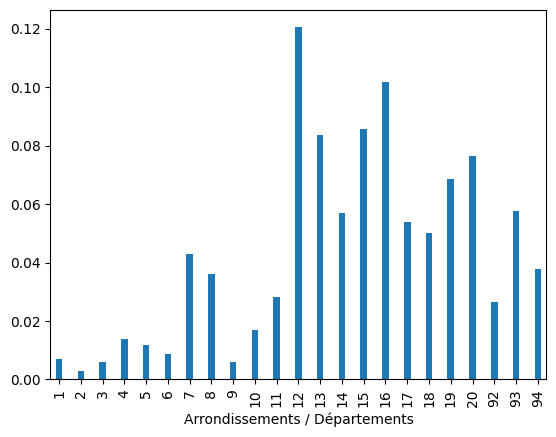

In [21]:
# Répartition des arbres par arrondissement
data["arrond"].value_counts(normalize=True).sort_index().plot(kind='bar', width=0.3)
plt.xlabel("Arrondissements / Départements")
plt.show()

In [22]:
# arbres dans arrondissements le long du périph
nb_long_periph = data.loc[data["arrond"]>=12,"arrond"]
print("Les arrondissements le long du périphérique (à partir du 12e) contiennent", round(len(nb_long_periph)/len(data)*100, 1), "% du total.")

# forte densité d'arbre dans le 7e et le 8e
nb_78 = data.loc[(data["arrond"]==7) | (data["arrond"]==8),:]
nb_places_78 = data.loc[data["lieu"].str.contains("CHAMP DE MARS") | data["lieu"].str.contains("INVALIDES") | data["lieu"].str.contains("ELYSEES"),:]
print("Les arbres situés au Champs de Mars, aux Invalides et sur les Champs-Elysées représentent", round(len(nb_places_78)/len(nb_78)*100, 1), "% de la zone (7e et 8e).")

Les arrondissements le long du périphérique (à partir du 12e) contiennent 82.0 % du total.
Les arbres situés au Champs de Mars, aux Invalides et sur les Champs-Elysées représentent 31.1 % de la zone (7e et 8e).


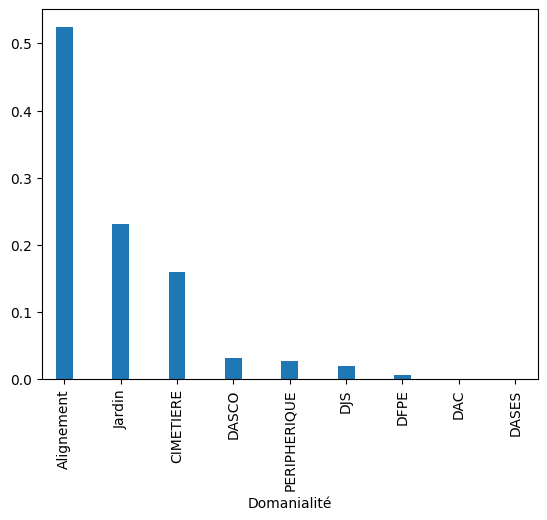

In [23]:
# Répartition des arbres par domanialité
data.loc[data["domanialite"]!="Autre","domanialite"].value_counts(normalize=True).plot(kind='bar', width=0.3)
plt.xlabel("Domanialité")
plt.show()

In [24]:
# arbres dans domanialité alignement cimetère jardin
nb_align_cim_jard = data.loc[(data["domanialite"]=="Jardin") | (data["domanialite"]=="Alignement") | (data["domanialite"]=="CIMETIERE"),:]
print("Les domanialités Alignement, Cimetière et Jardins contiennent", round(len(nb_align_cim_jard)/len(data)*100, 1), "% du total.")

# arbres dans domanialité alignement uniquement
nb_align = data.loc[data["domanialite"]=="Alignement",:]
print("La domanialité Alignement contient à elle seule", round(len(nb_align)/len(data)*100, 1), "% du total.")

Les domanialités Alignement, Cimetière et Jardins contiennent 91.5 % du total.
La domanialité Alignement contient à elle seule 52.4 % du total.


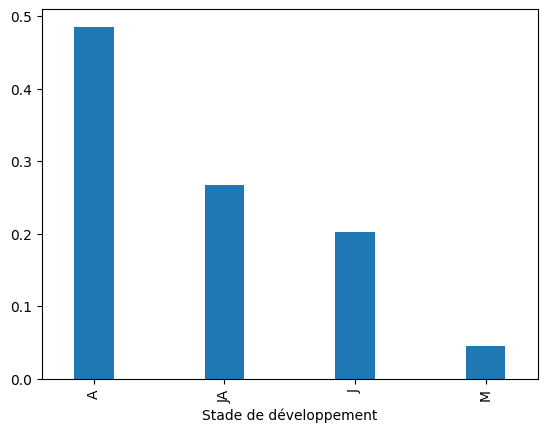

In [25]:
# Répartition des arbres par stade de développement
data.loc[data["stade_developpement"]!="Autre","stade_developpement"].value_counts(normalize=True).plot(kind='bar', width=0.3)
plt.xlabel("Stade de développement")
plt.show()

In [26]:
# arbres au stade de développement Adulte et Jeune Adulte principalement
nb_a_ja = data.loc[(data["stade_developpement"]=="A") | (data["stade_developpement"]=="JA"),:]
tot_wo_autre = data.loc[data["stade_developpement"]!="Autre",:]
print("Les stades de développement Adulte et Jeune Adulte représentent", round(len(nb_a_ja)/len(tot_wo_autre)*100, 1), "% des arbres ayant un stade de développement de renseigné.")

# arbres au stade de développement Adulte uniquement
nb_a = data.loc[data["stade_developpement"]=="A",:]
print("Les arbres au stade de développement Adulte représentent", round(len(nb_a)/len(tot_wo_autre)*100, 1), "% des arbres ayant un stade de développement de renseigné.")

Les stades de développement Adulte et Jeune Adulte représentent 75.1 % des arbres ayant un stade de développement de renseigné.
Les arbres au stade de développement Adulte représentent 48.5 % des arbres ayant un stade de développement de renseigné.


In [27]:
# pour afficher les pourcentages et les libellés pour les parts > 5%
limit_perc = 5
def show_perc(pct):
    return ('%.1f%%' % pct) if pct > limit_perc else ''

def show_labels(data):
    list = []
    for val, cnt in data.items():
        if (cnt*100/np.sum(data)) > limit_perc :
            list.append(val)
        else:
            list.append('')
    return list

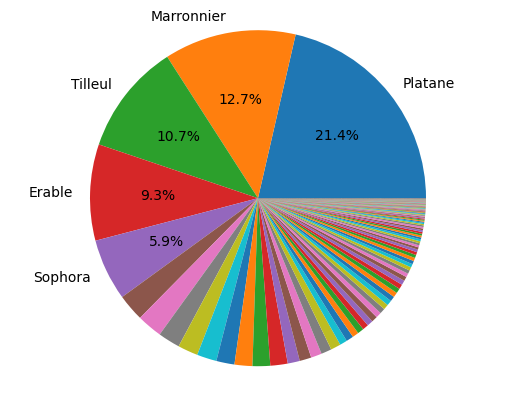

In [28]:
# représentation du genre en français
temp_val_count = data.loc[data["libelle_francais"].notnull(),"libelle_francais"].value_counts(normalize=True)
temp_val_count.plot(kind='pie', autopct=show_perc, labels=show_labels(temp_val_count), label='')
plt.axis('equal')
plt.show()

In [29]:
# majorité des genres d'arbre en français
maj_arbres = data.loc[(data["libelle_francais"]=="Platane") | (data["libelle_francais"]=="Marronnier") | (data["libelle_francais"]=="Tilleul") | (data["libelle_francais"]=="Erable") | (data["libelle_francais"]=="Sophora"),:]
print("Les principales espèces d'arbres représentent ", round(len(maj_arbres)/len(data)*100, 1), " % du total.")

Les principales espèces d'arbres représentent  59.6  % du total.


***
# IV) Analyse de la problématique

## 1) Quelle est la répartition des circonférences en fonction des arrondissements ?

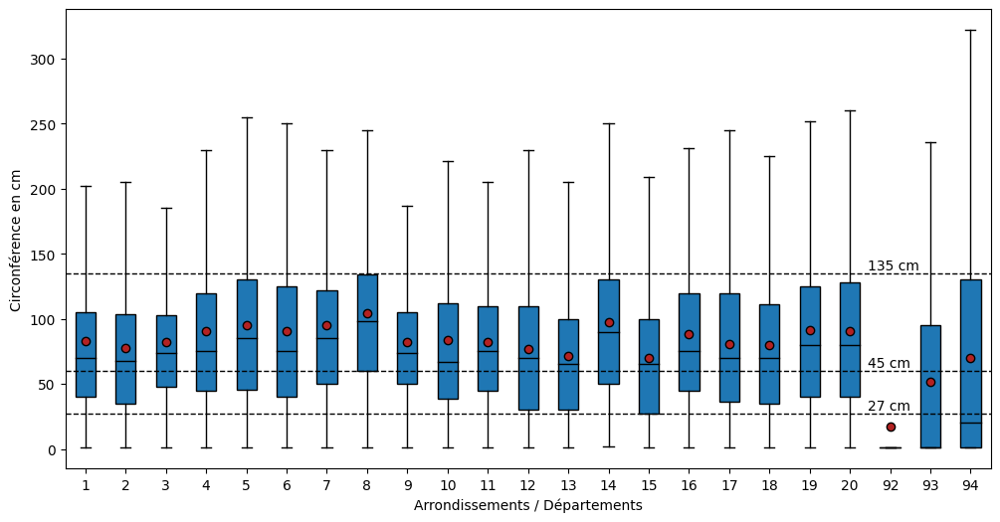

In [30]:
# Circonférence en fonction de la localisation
X = "arrond" # qualitative
Y = "circonference_cm" # quantitative

groupes = []
arrond_unique = sorted(data.arrond.unique())
for m in arrond_unique:
    groupes.append(data[data[X]==m][Y])

# Propriétés graphiques    
medianprops = {'color':"black"}
meanprops = {'marker':'o', 'markeredgecolor':'black',
            'markerfacecolor':'firebrick'}
plt.figure(figsize=(12,6))
plt.boxplot(groupes, labels=arrond_unique, showfliers=False, medianprops=medianprops, 
            vert=True, patch_artist=True, showmeans=True, meanprops=meanprops)
plt.xlabel("Arrondissements / Départements")
plt.ylabel("Circonférence en cm")
# pour tracer les lignes des limites pour discuter sur le graphique
min_xlim, max_xlim = plt.xlim()
plt.axhline(27, color='k', linestyle='dashed', linewidth=1)
plt.text(max_xlim*0.87, 30, '27 cm')
plt.axhline(60, color='k', linestyle='dashed', linewidth=1)
plt.text(max_xlim*0.87, 63, '45 cm')
plt.axhline(135, color='k', linestyle='dashed', linewidth=1)
plt.text(max_xlim*0.87, 138, '135 cm')
plt.show()

In [31]:
# proportion d'arbre de 1 cm de circonférence dans le 92
arbres_92 = data.loc[data["arrond"]==92,:]
arbres_92_wo_circ = arbres_92.loc[arbres_92["circonference_cm"]==1]
print("Les arbres du 92 ayant une circonférence de 1 cm représentent", round(len(arbres_92_wo_circ)/len(arbres_92)*100, 1), "% de la population.")

# circonférence moyenne dans la petite couronne
arbres_petite_couronne = data.loc[data["arrond"]>=92,:]
print("moyenne petite couronne : ", round(arbres_petite_couronne["circonference_cm"].mean(), 1), "%")

# circonférence moyenne dans le "demi-centre"
arbres_4_a_8 = data.loc[(data["arrond"]>=4) & (data["arrond"]<=8),:]
print("moyenne 'demi-centre' : ", round(arbres_4_a_8["circonference_cm"].mean(), 1), "%")

# circonférence moyenne pour les arbres du 12, 13 et 15e
arbres_12_13_15 = data.loc[(data["arrond"]==12) | (data["arrond"]==13) | (data["arrond"]==15),:]
print("moyenne 12e, 13e et 15e: ", round(arbres_12_13_15["circonference_cm"].mean(), 1), "%")

Les arbres du 92 ayant une circonférence de 1 cm représentent 77.4 % de la population.
moyenne petite couronne :  49.7 %
moyenne 'demi-centre' :  97.3 %
moyenne 12e, 13e et 15e:  73.3 %


## 2) Quelle est la répartition des hauteurs en fonction des arrondissements ?

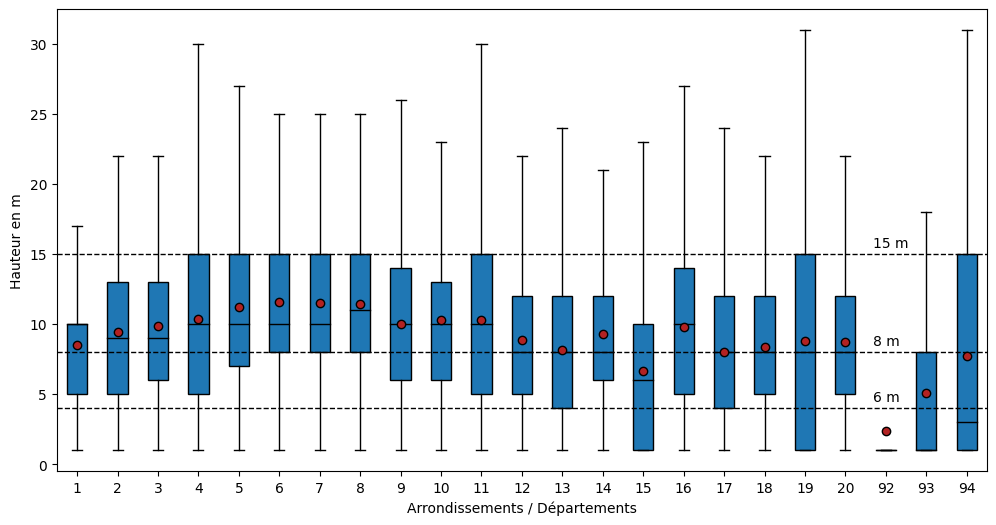

In [32]:
# Hauteur en fonction de la localisation
X = "arrond" # qualitative
Y = "hauteur_m" # quantitative

groupes = []
for m in arrond_unique:
    groupes.append(data[data[X]==m][Y])

# Propriétés graphiques    
medianprops = {'color':"black"}
meanprops = {'marker':'o', 'markeredgecolor':'black',
            'markerfacecolor':'firebrick'}
plt.figure(figsize=(12,6))
plt.boxplot(groupes, labels=arrond_unique, showfliers=False, medianprops=medianprops, 
            vert=True, patch_artist=True, showmeans=True, meanprops=meanprops)
plt.xlabel("Arrondissements / Départements")
plt.ylabel("Hauteur en m")
# pour tracer les lignes des limites pour discuter sur le graphique
min_xlim, max_xlim = plt.xlim()
plt.axhline(4, color='k', linestyle='dashed', linewidth=1)
plt.text(max_xlim*0.88, 4.5, '6 m')
plt.axhline(8, color='k', linestyle='dashed', linewidth=1)
plt.text(max_xlim*0.88, 8.5, '8 m')
plt.axhline(15, color='k', linestyle='dashed', linewidth=1)
plt.text(max_xlim*0.88, 15.5, '15 m')
plt.show()

In [33]:
# proportion d'arbre de 1 m de hauteur dans le 92
arbres_92_wo_haut = arbres_92.loc[arbres_92["hauteur_m"]==1]
print("Les arbres du 92 ayant une hauteur de 1 m représentent", round(len(arbres_92_wo_haut)/len(arbres_92)*100, 1), "% de la population.")

# hauteur moyenne dans la petite couronne + 15 et 19
arbres_haut_petits = data.loc[(data["arrond"]>=92) | (data["arrond"]==15) | (data["arrond"]==19),:]
print("moyenne petite couronne, 15e et 19e: ", round(arbres_haut_petits["hauteur_m"].mean(), 1), "%")

# hauteur moyenne dans le "demi-centre"
print("moyenne 'demi-centre': ", round(arbres_4_a_8["hauteur_m"].mean(), 1), "%")

Les arbres du 92 ayant une hauteur de 1 m représentent 83.1 % de la population.
moyenne petite couronne, 15e et 19e:  6.6 %
moyenne 'demi-centre':  11.3 %


## 3) Quelle est la répartition des circonférences en fonction de la domanialité ?

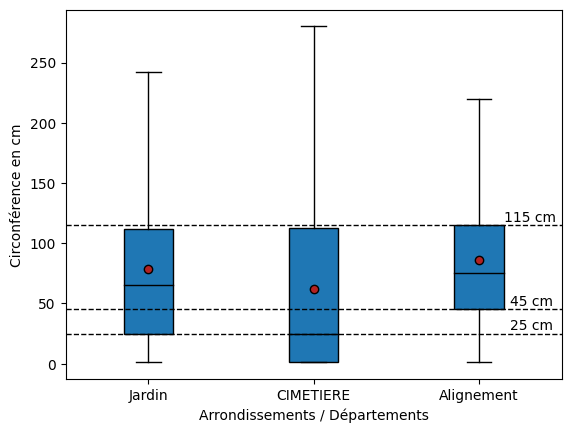

In [34]:
# Circonférence en fonction de la domanialité
X = "domanialite" # qualitative
Y = "circonference_cm" # quantitative

groupes = []
doman = ['Jardin', 'CIMETIERE', 'Alignement']
for m in doman:
    groupes.append(data[data[X]==m][Y])

# Propriétés graphiques    
medianprops = {'color':"black"}
meanprops = {'marker':'o', 'markeredgecolor':'black',
            'markerfacecolor':'firebrick'}
    
plt.boxplot(groupes, labels=doman, showfliers=False, medianprops=medianprops, 
            vert=True, patch_artist=True, showmeans=True, meanprops=meanprops)
plt.xlabel("Arrondissements / Départements")
plt.ylabel("Circonférence en cm")
# pour tracer les lignes des limites pour discuter sur le graphique
min_xlim, max_xlim = plt.xlim()
plt.axhline(25, color='k', linestyle='dashed', linewidth=1)
plt.text(max_xlim*0.91, 28, '25 cm')
plt.axhline(45, color='k', linestyle='dashed', linewidth=1)
plt.text(max_xlim*0.91, 48, '45 cm')
plt.axhline(115, color='k', linestyle='dashed', linewidth=1)
plt.text(max_xlim*0.9, 118, '115 cm')
plt.show()

## 4) Quelle est la répartition des hauteurs en fonction de la domanialité ?

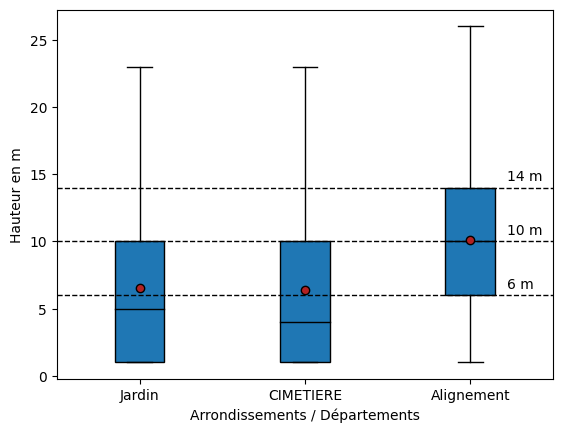

In [35]:
# Hauteur en fonction de la domanialité
X = "domanialite" # qualitative
Y = "hauteur_m" # quantitative

groupes = []
doman = ['Jardin', 'CIMETIERE', 'Alignement']
for m in doman:
    groupes.append(data[data[X]==m][Y])

# Propriétés graphiques    
medianprops = {'color':"black"}
meanprops = {'marker':'o', 'markeredgecolor':'black',
            'markerfacecolor':'firebrick'}
    
plt.boxplot(groupes, labels=doman, showfliers=False, medianprops=medianprops, 
            vert=True, patch_artist=True, showmeans=True, meanprops=meanprops)
plt.xlabel("Arrondissements / Départements")
plt.ylabel("Hauteur en m")
# pour tracer les lignes des limites pour discuter sur le graphique
min_xlim, max_xlim = plt.xlim()
plt.axhline(6, color='k', linestyle='dashed', linewidth=1)
plt.text(max_xlim*0.92, 6.5, '6 m')
plt.axhline(10, color='k', linestyle='dashed', linewidth=1)
plt.text(max_xlim*0.92, 10.5, '10 m')
plt.axhline(14, color='k', linestyle='dashed', linewidth=1)
plt.text(max_xlim*0.92, 14.5, '14 m')
plt.show()

## 5) Quels sont les principaux genres d’arbre par arrondissement ?

In [36]:
# méthode pour colorer les cellules du dataframe suivant
def highlight_cells(val):
    color = ""
    if val == "Platane":
        color = 'lightgreen'
    elif val == "Marronnier":
        color = 'lightcoral'
    elif val == "Erable":
        color = "lightblue"
    elif val == "Tilleul":
        color = "violet"
    elif val == "Sophora":
        color = "sandybrown"
    return 'background-color: {}'.format(color)

In [37]:
# représentation du genre en français par arrondissement
rank_genre_arrond = []
for a in arrond_unique:
    temp_pie_data = data.loc[data["arrond"]==a,"libelle_francais"].value_counts(normalize=True)
    i=0
    temp_to_append = {
        "arr/dpt": a,
        "Genre princ.": "",
        "Genre second.": ""
    }
    for val, cnt in temp_pie_data.items():
        i+=1
        if i == 1:
            temp_to_append["Genre princ."] = val
        elif i == 2:
            temp_to_append["Genre second."] = val
        else:
            break
    rank_genre_arrond.append(temp_to_append)
    
rank_genre_arrond = pd.DataFrame(rank_genre_arrond)
rank_genre_arrond.head(25)
# appliquer la coloration en fonction des genres d'arbre
rank_genre_arrond.style.applymap(highlight_cells)

,arr/dpt,Genre princ.,Genre second.
0,1,Platane,Tilleul
1,2,Platane,Sophora
2,3,Platane,Chêne
3,4,Platane,Tilleul
4,5,Platane,Marronnier
5,6,Platane,Marronnier
6,7,Platane,Tilleul
7,8,Marronnier,Platane
8,9,Platane,Micocoulier
9,10,Platane,Orme


## 6) Quelle est la répartition des arbres remarquables par arrondissement ?

In [38]:
# filtre sur les arbres remarquables
arbres_remarquables = data.loc[data["remarquable"]==1,:]
print("Il y a ", len(arbres_remarquables), " arbres remarquables soit ", round(len(arbres_remarquables)/len(data)*100, 2), " % du total.")

Il y a  184  arbres remarquables soit  0.09  % du total.


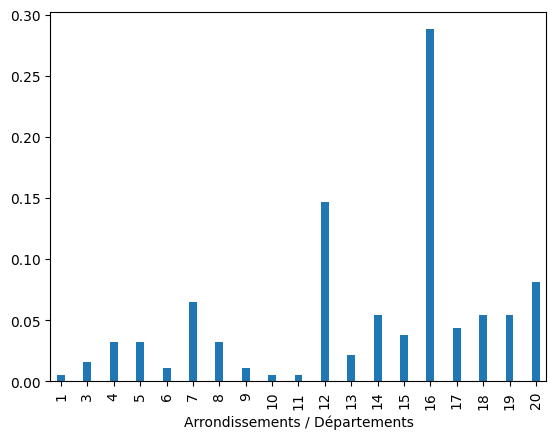

In [39]:
# Répartition des arbres par arrondissement
arbres_remarquables["arrond"].value_counts(normalize=True).sort_index().plot(kind='bar', width=0.3)
plt.xlabel("Arrondissements / Départements")
plt.show()

In [40]:
# forte densité d'arbre dans le 7e, 12e, 16e et 20e
nb_12_16_7_20 = arbres_remarquables.loc[
    (arbres_remarquables["arrond"]>=12) | (arbres_remarquables["arrond"]==16) |
    (arbres_remarquables["arrond"]==7) | (arbres_remarquables["arrond"]==20),:]
print("Les arrondissements (7e, 12e, 16e et 20e) les plus fortement peuplés en arbres remarquables regroupent", round(len(nb_12_16_7_20)/len(arbres_remarquables)*100, 1), "% des arbres remarquables.")

# majorité des arbres dans les arrondissements le long du périphérique
nb_sup_12 = arbres_remarquables.loc[arbres_remarquables["arrond"]>=12,:]
print("Les arbres remarquables sont situés à", round(len(nb_sup_12)/len(arbres_remarquables)*100, 1), "% dans les arrondissements le long du périphérique.")

Les arrondissements (7e, 12e, 16e et 20e) les plus fortement peuplés en arbres remarquables regroupent 84.8 % des arbres remarquables.
Les arbres remarquables sont situés à 78.3 % dans les arrondissements le long du périphérique.


## 7) Quels sont les principaux genres d’arbre remarquable ?

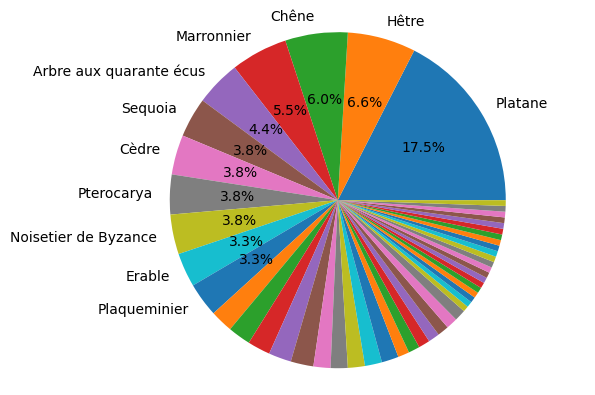

In [41]:
# représentation du genre en français
limit_perc = 3
temp_val_count = arbres_remarquables.loc[arbres_remarquables["libelle_francais"].notnull(),"libelle_francais"].value_counts(normalize=True)
temp_val_count.plot(kind='pie', autopct=show_perc, labels=show_labels(temp_val_count),label='')
plt.axis('equal')
plt.show()

In [42]:
# majorité des genres d'arbre en français
maj_arbres_remarq = arbres_remarquables.loc[
    (data["libelle_francais"]=="Platane") | (data["libelle_francais"]=="Hêtre") |
    (data["libelle_francais"]=="Chêne") | (data["libelle_francais"]=="Marronnier") |
    (data["libelle_francais"]=="Arbre aux quarante écus") | (data["libelle_francais"]=="Sequoia") |
    (data["libelle_francais"]=="Cèdre") | (data["libelle_francais"]=="Pterocarya") |
    (data["libelle_francais"]=="Noisetier de Byzance") | (data["libelle_francais"]=="Erable") |
    (data["libelle_francais"]=="Plaqueminier"),:]
print("Nombre de genres chez les arbres remarquables :", len(arbres_remarquables["libelle_francais"].unique()))
print("Les principales espèces d'arbres remarquables représentent", round(len(maj_arbres_remarq)/len(arbres_remarquables)*100, 1), "% des arbres remarquables.")

Nombre de genres chez les arbres remarquables : 50
Les principales espèces d'arbres remarquables représentent 61.4 % des arbres remarquables.


***
# V) Synthèse de l'analyse de données

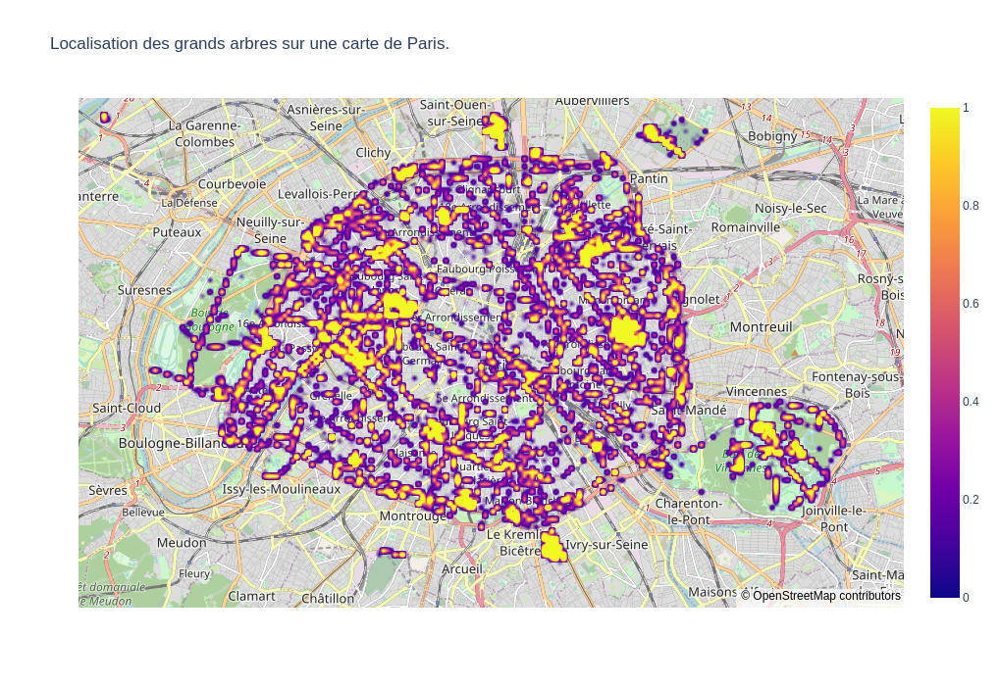

In [43]:
# représentation des grands arbres sur une carte
subset = data.loc[(data["hauteur_m"]>=11) & (data["circonference_cm"]>=105),:]
fig = px.density_mapbox(subset,
lat='geo_point_2d_a', lon='geo_point_2d_b',
hover_data=['arrondissement', 'lieu'],
radius=2, zoom=11,
mapbox_style="open-street-map",
title="Localisation des grands arbres sur une carte de Paris.",
width=900, height=700,)
fig.show()

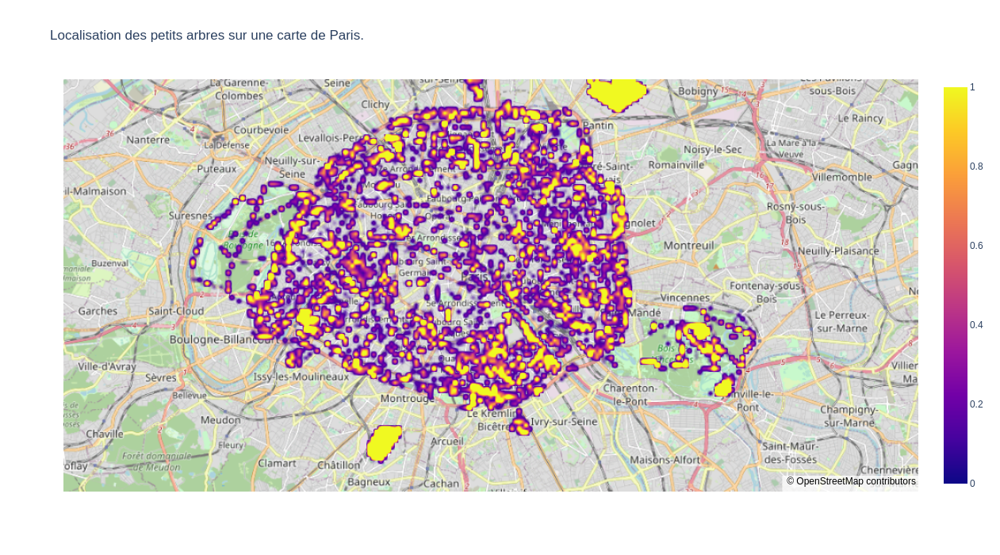

In [44]:
# représentation des petits arbres sur une carte
subset = data.loc[(data["hauteur_m"]<=6) & (data["circonference_cm"]<=45),:]
fig = px.density_mapbox(subset,
lat='geo_point_2d_a', lon='geo_point_2d_b',
hover_data=['arrondissement', 'lieu'],
radius=2, zoom=11,
mapbox_style="open-street-map",
title="Localisation des petits arbres sur une carte de Paris.",
width=900, height=700,)
fig.show()

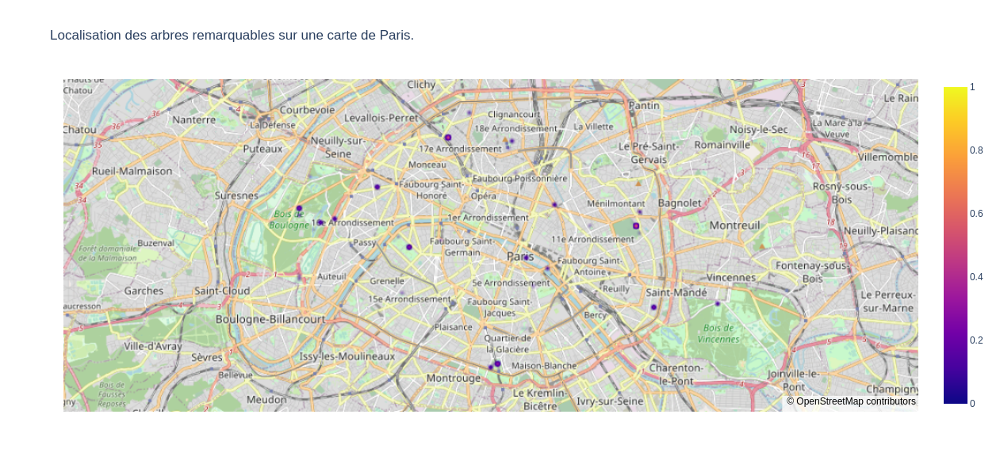

In [45]:
# représentation des arbres remarquables sur une carte
fig = px.density_mapbox(maj_arbres_remarq,
lat='geo_point_2d_a', lon='geo_point_2d_b',
hover_data=['arrondissement', 'lieu'],
radius=2, zoom=11,
mapbox_style="open-street-map",
title="Localisation des arbres remarquables sur une carte de Paris.",
width=900, height=600,)
fig.show()